<a href="https://colab.research.google.com/github/lucas8k/deep_learning_guita_chord_classification/blob/main/Deep_Learning_Guitar_Chord_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Set Up Envivironment

This section will set up the environment and download all required dependencies. 

In [1]:
!git clone https://github.com/dusty-nv/pytorch-ssd.git pytorch_ssd
%cd pytorch_ssd

import torch
import numpy as np

# set a seed for repcodusability. See https://pytorch.org/docs/stable/notes/randomness.html

SEED = 42

torch.manual_seed(SEED)
np.random.seed(0)

Cloning into 'pytorch_ssd'...
remote: Enumerating objects: 900, done.
remote: Total 900 (delta 0), reused 0 (delta 0), pack-reused 900
Receiving objects: 100% (900/900), 1.07 MiB | 19.94 MiB/s, done.
Resolving deltas: 100% (597/597), done.
/content/pytorch_ssd


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# First Iteration - Simple Detection

The goal of the first iteration is to build a simple chord classifier on a small dataset to see how far we will get and where improvements are necessary. 


## Data Preperation
First the dataset will be downloaded and and analyzed to get a understanding of the data. 

In [ ]:
# Extract the data
!unzip "/content/drive/MyDrive/Master/dataset_chord_simple_train.zip" -d data/
!unzip "/content/drive/MyDrive/Master/dataste_chords_simple_test.zip" -d data/

Archive:  /content/drive/MyDrive/Master/dataste_chords_simple_test.zip
   creating: data/dataset_third_val/
   creating: data/dataset_third_val/a_chord/
   creating: data/dataset_third_val/c_chord/
   creating: data/dataset_third_val/g_chord/
  inflating: data/dataset_third_val/.DS_Store  
  inflating: data/__MACOSX/dataset_third_val/._.DS_Store  
   creating: data/dataset_third_val/e_chord/
   creating: data/dataset_third_val/d_chord/
  inflating: data/dataset_third_val/a_chord/2-a_chord-21.jpg  
  inflating: data/dataset_third_val/a_chord/7-a_chord-1.jpg  
  inflating: data/dataset_third_val/a_chord/7-a_chord-0.jpg  
  inflating: data/dataset_third_val/a_chord/2-a_chord-20.jpg  
  inflating: data/dataset_third_val/a_chord/2-a_chord-22.jpg  
  inflating: data/dataset_third_val/a_chord/7-a_chord-2.jpg  
  inflating: data/dataset_third_val/a_chord/7-a_chord-3.jpg  
  inflating: data/dataset_third_val/a_chord/2-a_chord-23.jpg  
  inflating: data/dataset_third_val/a_chord/2-a_chord-8.jpg 

In [ ]:
# Imports
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
from torchvision import datasets, transforms, models
import helper
import torchvision
import time
import os
import copy
%matplotlib inline

First we will visialize the dataset and see how large the dataset ist. 

There are 5 classes classes in the dataset, which are ['c_chord', 'd_chord', 'g_chord', 'e_chord', 'a_chord']


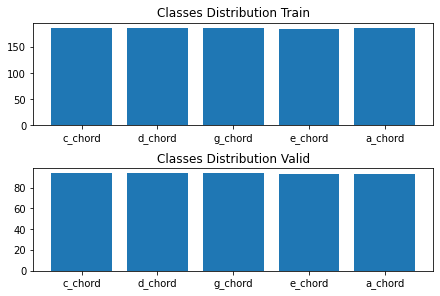

In [ ]:
data_root_train = "data/dataset_third"
data_root_valid = "data/dataset_third_val"

classes = [c for c in os.listdir(data_root_train) if not c.startswith(".")]

print("There are {} classes classes in the dataset, which are {}".format(len(classes), classes))

count_per_class_train = []
count_per_class_valid = []

for c in classes:
  count_per_class_train.append((c, len(os.listdir(os.path.join(data_root_train, c)))))

for c in classes:
  count_per_class_valid.append((c, len(os.listdir(os.path.join(data_root_valid, c)))))

fig, axs = plt.subplots(2, 1, constrained_layout=True)
chords_train = [c[0] for c in count_per_class_train]
count_train = [c[1] for c in count_per_class_train]
axs[0].set_title('Classes Distribution Train')
axs[0].bar(chords_train,count_train)

chords_valid = [c[0] for c in count_per_class_valid]
count_valid = [c[1] for c in count_per_class_valid]
axs[1].bar(chords_valid,count_valid)
axs[1].set_title('Classes Distribution Valid')
plt.show()




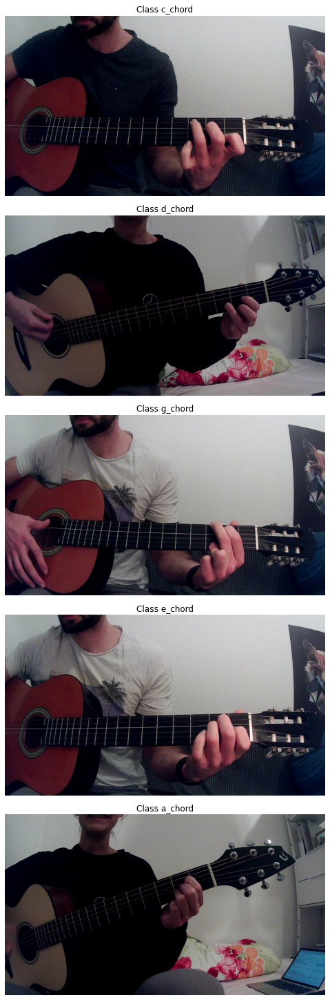

In [ ]:
from matplotlib.pyplot import imshow
import numpy as np
from PIL import Image

fig, axs = plt.subplots(len(classes), 1, constrained_layout=True, figsize=(20,20))

for ax in axs.flatten():
    ax.axis('off')

# Visualize a image for each class
i = 0
for c in classes:
  image = Image.open(
      os.path.join(data_root_train, c,
      os.listdir(os.path.join(data_root_train, c))[0]), 'r')
  axs[i].imshow(np.asarray(image))
  axs[i].set_title('Class {}'.format(c))
  i += 1
plt.show()

In [ ]:
image_size = (224, 224)

# function for loading and splitting training/test and valid data
def load_data(train_dir, test_dir=None, split=0.25, shuffle=True, batch_size=5):
  transfom = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
  


  dataset = datasets.ImageFolder(train_dir,  
                                      transform=transfom)  

  train_set , val_set = torch.utils.data.random_split(dataset, 
                                                      [int(len(dataset) * (1 - split)), 
                                                      len(dataset) - int((len(dataset) * (1 - split)))])

  class_names = dataset.classes
                                             
  dataloaders = {}
  dataset_sizes = {}

  dataloaders['train'] = torch.utils.data.DataLoader(train_set,
                                                    batch_size=batch_size, shuffle=shuffle)
  dataset_sizes['train'] = len(dataloaders['train']) * batch_size

  dataloaders['val'] = torch.utils.data.DataLoader(val_set,
                                                    batch_size=batch_size, shuffle=shuffle)
  
  dataset_sizes['val'] = len(dataloaders['val']) * batch_size

  
  

  if test_dir != None:
    dataset_test = datasets.ImageFolder(test_dir,  
                                      transform=transfom)  
    dataloaders['test'] = torch.utils.data.DataLoader(dataset_test,
                                                    batch_size=batch_size, shuffle=shuffle)
    dataset_sizes['test'] = len(dataloaders['test']) * batch_size

  
  return class_names, dataloaders, dataset_sizes


For the first iteration we will only use three chords wich are easily distinguishable. 

In [ ]:
import shutil

three_chords = ["c_chord", "g_chord", "a_chord"]

data_three_chord_train = 'data/dataset_three_chords'
data_three_chord_valid = 'data/dataset_three_chords_valid'

#shutil.rmtree(data_three_chord_train)
#shutil.rmtree(data_three_chord_valid)

# copy only the three chords to new folder

if not os.path.exists(data_three_chord_train):
  for chord in three_chords:
    shutil.copytree(os.path.join(data_root_train, chord), os.path.join(data_three_chord_train, chord))  
if not os.path.exists(data_three_chord_valid):
  for chord in three_chords:
    shutil.copytree(os.path.join(data_root_valid, chord), os.path.join(data_three_chord_valid, chord))  

BATCH_SIZE = 5
TRAIN_TEST_SPLIT = 0.25

#load dataset
class_names, dataloaders, dataset_sizes = load_data(data_root_train, 
                        test_dir=data_root_valid, 
                        split=TRAIN_TEST_SPLIT, shuffle=True, batch_size=BATCH_SIZE)


print("Loaded the classes {}".format(class_names))
print("Dataset sizes {}".format(dataset_sizes))



Loaded the classes ['a_chord', 'c_chord', 'd_chord', 'e_chord', 'g_chord']
Dataset sizes {'train': 695, 'val': 235, 'test': 465}


## Model Training

In [ ]:
# define a function to train the model
def train_model(model, criterion, optimizer, scheduler, num_epochs=5):
    since = time.time()

    # best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if phase == 'train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    # model.load_state_dict(best_model_wts)
    return model

# define a function to test the model
def test_model(model, dataset="val"):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    model.eval()   # Set model to evaluate mode
    running_loss = 0.0
    running_corrects = 0

    # Iterate over data.
    for inputs, labels in dataloaders[dataset]:
        inputs = inputs.to(device)
        labels = labels.to(device)


        with torch.set_grad_enabled(False):
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion(outputs, labels)

        # statistics
        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    loss = running_loss / dataset_sizes[dataset]
    acc = running_corrects.double() / dataset_sizes[dataset]


    print('Predicting correct {} out of {} images. Loss: {:.4f} Acc: {:.4f}'.format(
        running_corrects, dataset_sizes[dataset], loss, acc))


In [ ]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

# define a function to visualize predictions
def visualize_model(model, num_images=8):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['test']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {} --- acutal {}'.format(class_names[preds[j]], class_names[labels[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

In [ ]:
#set the device. GPU if possible else CPU
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

#load the pretrained resnet 18 model
model_ft = models.resnet18(pretrained=True)
num_ftrs = model_ft.fc.in_features

model_ft.fc = nn.Linear(num_ftrs, len(class_names))

model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

In [ ]:
#Train the model
model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler,
                       num_epochs=3)

Epoch 0/2
----------
train Loss: 0.9369 Acc: 0.6014
val Loss: 0.0921 Acc: 0.9447

Epoch 1/2
----------
train Loss: 0.2038 Acc: 0.9338
val Loss: 0.0356 Acc: 0.9830

Epoch 2/2
----------
train Loss: 0.0766 Acc: 0.9827
val Loss: 0.0053 Acc: 0.9872

Training complete in 11m 38s
Best val Acc: 0.987234


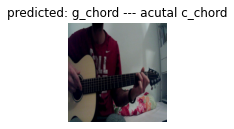

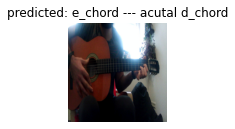

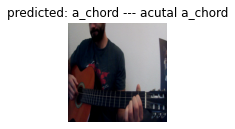

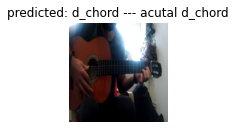

In [ ]:
visualize_model(model_ft, num_images=4)

In [ ]:
test_model(model_ft, dataset="test")

Predicting correct 322 out of 465 images. Loss: 0.9226 Acc: 0.6925


In [ ]:
torch.save(model_ft.state_dict(), "models/chord_classifier.pt")

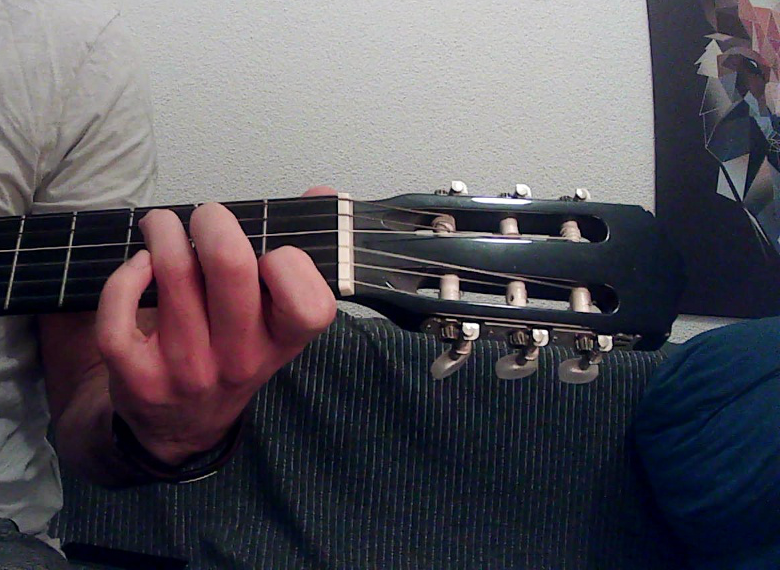

In [ ]:
# crop images
from PIL import Image
img = Image.open("data/dataset_third/c_chord/1-c_chord-1.jpg")
w, h = img.size
img.crop((500, 150, w, h))

In [ ]:
import shutil 

shutil.copytree("data/dataset_third", "data/dataset_third_cropped")
shutil.copytree("data/dataset_third_val", "data/dataset_third_val_cropped")    

for path, subdirs, files in os.walk("data/dataset_third_cropped"):
  for name in files:
    if name.endswith(".jpg"):
      img = Image.open(os.path.join(path, name))
      w, h = img.size
      img.crop((500, 150, w, h)).save(os.path.join(path, name))
for path, subdirs, files in os.walk("data/dataset_third_val_cropped"):
  for name in files:
    if name.endswith(".jpg"):
      img = Image.open(os.path.join(path, name))
      w, h = img.size
      img.crop((500, 150, w, h)).save(os.path.join(path, name))

# Second Iteration - Guitar Hand Detection

In [3]:
#download mobilenet single shot detector weights
!mkdir models/mobilenet
!wget https://nvidia.box.com/shared/static/djf5w54rjvpqocsiztzaandq1m3avr7c.pth -O models/mobilenet/mobilenet-v1-ssd-mp-0_675.pth

--2021-01-05 21:09:10--  https://nvidia.box.com/shared/static/djf5w54rjvpqocsiztzaandq1m3avr7c.pth
Resolving nvidia.box.com (nvidia.box.com)... 107.152.24.197
Connecting to nvidia.box.com (nvidia.box.com)|107.152.24.197|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /public/static/djf5w54rjvpqocsiztzaandq1m3avr7c.pth [following]
--2021-01-05 21:09:10--  https://nvidia.box.com/public/static/djf5w54rjvpqocsiztzaandq1m3avr7c.pth
Reusing existing connection to nvidia.box.com:443.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://nvidia.app.box.com/public/static/djf5w54rjvpqocsiztzaandq1m3avr7c.pth [following]
--2021-01-05 21:09:10--  https://nvidia.app.box.com/public/static/djf5w54rjvpqocsiztzaandq1m3avr7c.pth
Resolving nvidia.app.box.com (nvidia.app.box.com)... 107.152.24.201
Connecting to nvidia.app.box.com (nvidia.app.box.com)|107.152.24.201|:443... connected.
HTTP request sent, awaiting response... 302 Found
Loca

In [4]:
!cat requirements.txt 
!pip install -r requirements.txt 


boto3
pandas
urllib3Collecting boto3
     |████████████████████████████████| 133kB 8.2MB/s 
     |████████████████████████████████| 71kB 5.2MB/s 
     |████████████████████████████████| 7.2MB 11.9MB/s 
ERROR: botocore 1.19.49 has requirement urllib3<1.27,>=1.25.4; python_version != "3.4", but you'll have urllib3 1.24.3 which is incompatible.


## Data Preperation

In [5]:
# download egohands dataset in voc format
!curl -L "https://public.roboflow.com/ds/QIbpYlBhgg?key=Q0aTjibUJI" > roboflow.zip; unzip roboflow.zip -d data/egohands; rm roboflow.zip

Die letzten 5000 Zeilen der Streamingausgabe wurden abgeschnitten.
 extracting: data/egohands/train/CHESS_OFFICE_S_B_frame_1765_jpg.rf.44b7344477ef79377bb8dfacdf0dc370.xml  
 extracting: data/egohands/train/CHESS_OFFICE_S_B_frame_1833_jpg.rf.022954d00309f491eac872e088e39b5c.jpg  
 extracting: data/egohands/train/CHESS_OFFICE_S_B_frame_1833_jpg.rf.022954d00309f491eac872e088e39b5c.xml  
 extracting: data/egohands/train/CHESS_OFFICE_S_B_frame_1835_jpg.rf.590fec8edf44225bc922cc7cc06947fd.jpg  
 extracting: data/egohands/train/CHESS_OFFICE_S_B_frame_1835_jpg.rf.590fec8edf44225bc922cc7cc06947fd.xml  
 extracting: data/egohands/train/CHESS_OFFICE_S_B_frame_1841_jpg.rf.f4e3c7aea2d33581fa2ce493683314dd.jpg  
 extracting: data/egohands/train/CHESS_OFFICE_S_B_frame_1841_jpg.rf.f4e3c7aea2d33581fa2ce493683314dd.xml  
 extracting: data/egohands/train/CHESS_OFFICE_S_B_frame_1886_jpg.rf.431402cdca5d4a5bc3b9e6c46f8365a1.jpg  
 extracting: data/egohands/train/CHESS_OFFICE_S_B_frame_1886_jpg.rf.431402cdc

In [6]:
#defining a few helper functions to visualize the data
from PIL import Image
import xml.etree.ElementTree as ET
import cv2


def load_boxes(filename):
  root = ET.parse(filename + ".xml").getroot()
  bboxes = []
  labels = []
  for object_tag in root.findall('object'):
    bbox_tag = object_tag.find('bndbox')
    labels.append(object_tag.find('name').text)
    bboxes.append((
        int(bbox_tag.find("xmin").text),
        int(bbox_tag.find("ymin").text),
        int(bbox_tag.find("xmax").text),
        int(bbox_tag.find("ymax").text)
      )
    )
  return bboxes, labels

def draw_boxes_on_image(image, labels=[], boxes=[]):
    for i in range(len(boxes)):
      cv2.rectangle(image, (boxes[i][0], boxes[i][1]), (boxes[i][2], boxes[i][3]), (255, 255, 0), 4)
      if labels != None:
        cv2.putText(image, labels[i],
                      (int(boxes[i][0]) + 20, int(boxes[i][1]) + 40),
                      cv2.FONT_HERSHEY_SIMPLEX,
                      1, 
                      (255, 0, 255),
                      2)  
    return image

def load_image(filename, draw_boxes=False, np_array=False):
  orig_image = np.array(Image.open(filename + ".jpg"))
  bboxes, labels = load_boxes(filename)
  if draw_boxes:
    draw_boxes_on_image(orig_image, labels=labels, boxes=bboxes)
  image = orig_image
  if not np_array:
    image = Image.fromarray(orig_image)
  return bboxes, labels, image

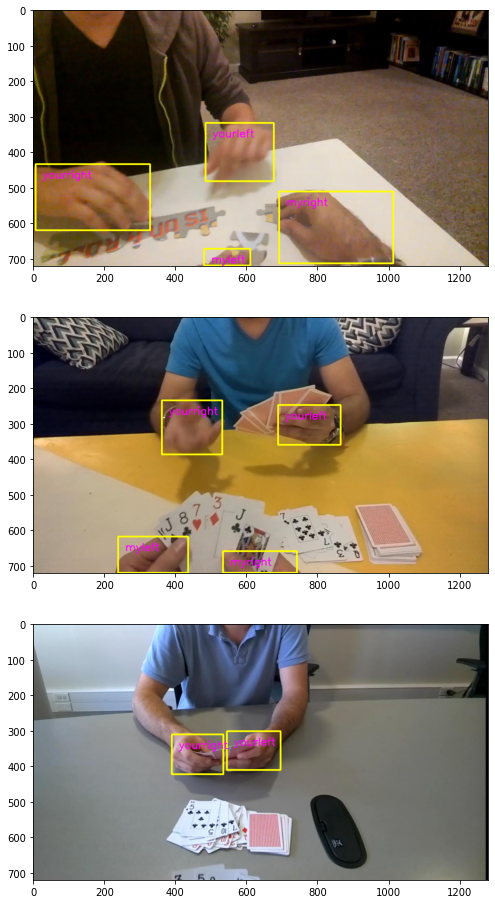

In [7]:
# look at a few images
import os
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
%matplotlib inline


base_path = "data/egohands/train"

filenames = [image.replace(".jpg", "") for image in 
             os.listdir(base_path) 
             if image.endswith(".jpg")]



fig=plt.figure(figsize=(16, 16))
columns = 1
rows = 3
for i in range(1, columns*rows +1):
    picture = random.sample(filenames, 3)[0]
    boxes, labels, image = load_image(os.path.join(base_path, picture), draw_boxes=True, np_array=True)
    fig.add_subplot(rows, columns, i)
    plt.imshow(image)
plt.show()



In [8]:
import fileinput

#Problem: Only your hands are required.
source_dirs = ['data/egohands/train', 'data/egohands/test', 'data/egohands/valid']

for source_dir in source_dirs:
  file_names = os.listdir(source_dir)   
  for file_name in file_names:
    if file_name.endswith("xml"):
      file_content = open(source_dir + "/" + file_name, 'r').read()
      if "myright" in file_content or "myleft" in file_content:
        os.remove(os.path.join(source_dir, file_name))
        os.remove(os.path.join(source_dir, file_name[:-3] + "jpg"))
      else:
        with fileinput.FileInput(os.path.join(source_dir, file_name), inplace=True) as file:
          for line in file:
              new_line = line
              new_line = new_line.replace("yourleft", "left_hand")
              new_line = new_line.replace("yourright", "right_hand")
              print(new_line, end='')

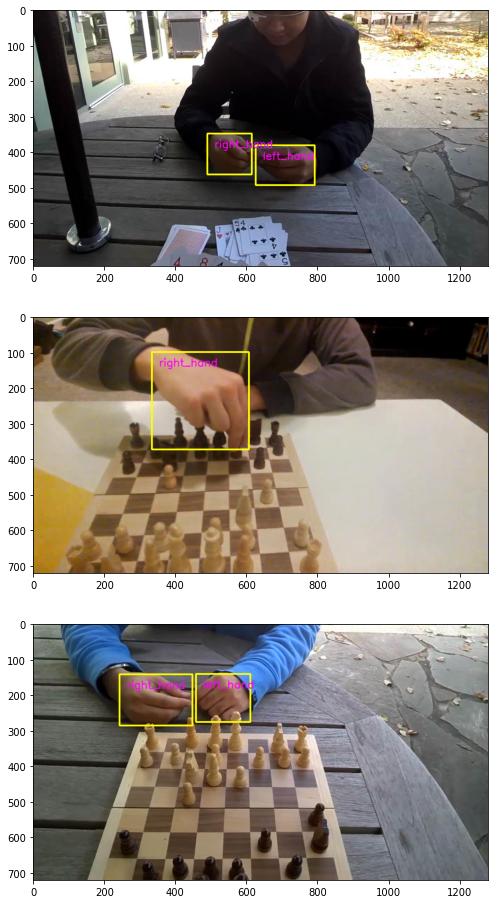

In [9]:
# display 3 random images again
base_path = "data/egohands/train"

filenames = [image.replace(".jpg", "") for image in 
             os.listdir(base_path) 
             if image.endswith(".jpg")]

# display 3 random images again

fig=plt.figure(figsize=(16, 16))
columns = 1
rows = 3
for i in range(1, columns*rows +1):
    picture = random.sample(filenames, 3)[0]
    boxes, labels, image = load_image(os.path.join(base_path, picture), draw_boxes=True, np_array=True)
    fig.add_subplot(rows, columns, i)
    plt.imshow(image)
plt.show()

In [10]:
print("The filtered dataset contains {} training images".format(len(filenames)))

The filtered dataset contains 852 training images


In [11]:
# defining a image argumenation pipeline
import imgaug as ia
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage
from PIL import Image
import numpy as np
import imgaug.augmenters as iaa
import os
import random
import string

def save_bounding_box(new_boxes, org_files, dest_file):
  tree = ET.parse(org_files)
  root = tree.getroot()
  i = 0
  for object_tag in root.iter('object'):
    bbox_tag = object_tag.find('bndbox')
    bbox_tag.find("xmin").text = (str(new_boxes[i]["xmin"]))
    bbox_tag.find("xmax").text = (str(new_boxes[i]["xmax"]))
    bbox_tag.find("ymin").text = (str(new_boxes[i]["ymin"]))
    bbox_tag.find("ymax").text = (str(new_boxes[i]["ymax"]))
    i += 1

  tree.write(dest_file)

def apply_augumentation(filename, seq, multiply=1, save=False, source_dir="", dest_dir=""):
  aug_images = []
  for c in range(multiply):

    boxes, labels, image = load_image(os.path.join(source_dir, filename), draw_boxes=False, np_array=True)
    annotation_name = filename + ".xml"

    bbs = BoundingBoxesOnImage([
        BoundingBox(x1=bbox[0], x2=bbox[2], y1=bbox[1], y2=bbox[3]) for bbox in boxes
    ], shape=image.shape)



    image_aug, bbs_aug = seq(image=image, bounding_boxes=bbs)
    aug_images.append((image_aug, bbs_aug.to_xyxy_array(), labels))

    if save:
      prefix = ''.join(random.choices(string.ascii_uppercase + string.digits, k=5))
      image = Image.fromarray(image_aug)
      image.save(os.path.join(dest_dir, "aug-" + prefix + filename + ".jpg"))

      save_bounding_box([{"xmin": int(bbox[0]),
              "xmax": int(bbox[2]),
              "ymin": int(bbox[1]),
              "ymax": int(bbox[3])} for bbox in bbs_aug.to_xyxy_array()], 
              os.path.join(source_dir, annotation_name),
              os.path.join(dest_dir, "aug-" + prefix  + annotation_name))
  return aug_images

In [12]:
aug_seq = iaa.Sequential([
  iaa.Fliplr(0.5), # horizontally flip 50% of the images
  iaa.Crop(percent=(0, 0.1)), # random crops
  # Small gaussian blur with random sigma between 0 and 0.5.
  # But we only blur about 50% of all images.
  iaa.Sometimes(
      0.5,
      iaa.GaussianBlur(sigma=(0, 0.5))
  ),
  # Strengthen or weaken the contrast in each image.
  iaa.LinearContrast((0.75, 1.5)),
  # Add gaussian noise.
  # For 50% of all images, we sample the noise once per pixel.
  # For the other 50% of all images, we sample the noise per pixel AND
  # channel. This can change the color (not only brightness) of the
  # pixels.
  iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5),
  # Make some images brighter and some darker.
  # In 20% of all cases, we sample the multiplier once per channel,
  # which can end up changing the color of the images.
  iaa.Multiply((0.8, 1.2), per_channel=0.2),
  # Apply affine transformations to each image.
  # Scale/zoom them, translate/move them, rotate them and shear them.
], random_order=True) # apply augmenters in random order

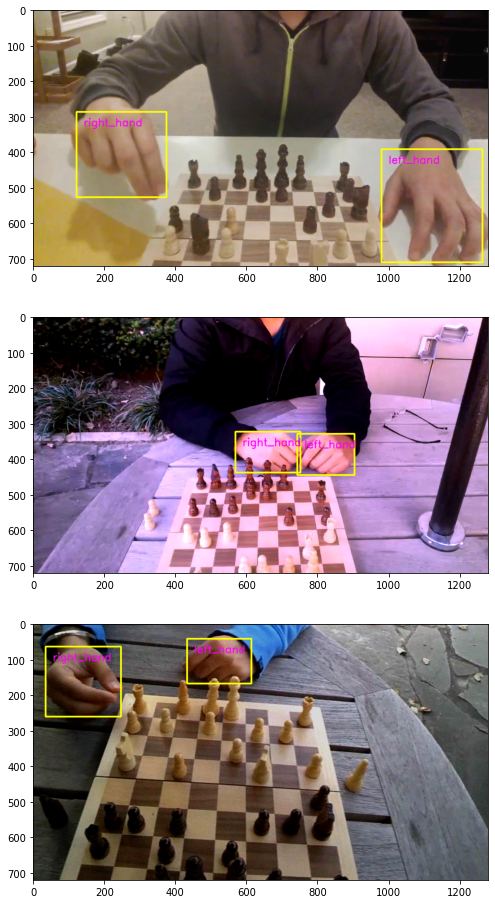

In [16]:
# test the augumentation pipeline on a few images
base_path = "data/egohands/train"

filenames = [image.replace(".jpg", "") for image in 
             os.listdir(base_path) 
             if image.endswith(".jpg")]

fig=plt.figure(figsize=(16, 16))
columns = 1
rows = 3
for i in range(1, columns*rows +1):
    picture = random.sample(filenames, 1)[0]
    aug_images = apply_augumentation(picture, aug_seq, multiply=1, save=False, source_dir=base_path)
    fig.add_subplot(rows, columns, i)
    plt.imshow(draw_boxes_on_image(aug_images[0][0], boxes=aug_images[0][1], labels=aug_images[0][2]))
plt.show()

In [17]:
# apply the argumentation on the whole dataset for test, train and valid
source_dirs = ['data/egohands/train', 'data/egohands/test', 'data/egohands/valid']

for source_dir in source_dirs:
  filenames = [image.replace(".jpg", "") for image in 
              os.listdir(source_dir) 
              if image.endswith(".jpg")]
  print("Applying image argumentation on {} images in the folder {}".format(len(filenames), source_dir))
  for picture in filenames:
    apply_augumentation(picture, aug_seq, multiply=2, save=True,  source_dir=source_dir, dest_dir=source_dir)


Applying image argumentation on 852 images in the folder data/egohands/train
Applying image argumentation on 101 images in the folder data/egohands/test
Applying image argumentation on 96 images in the folder data/egohands/valid


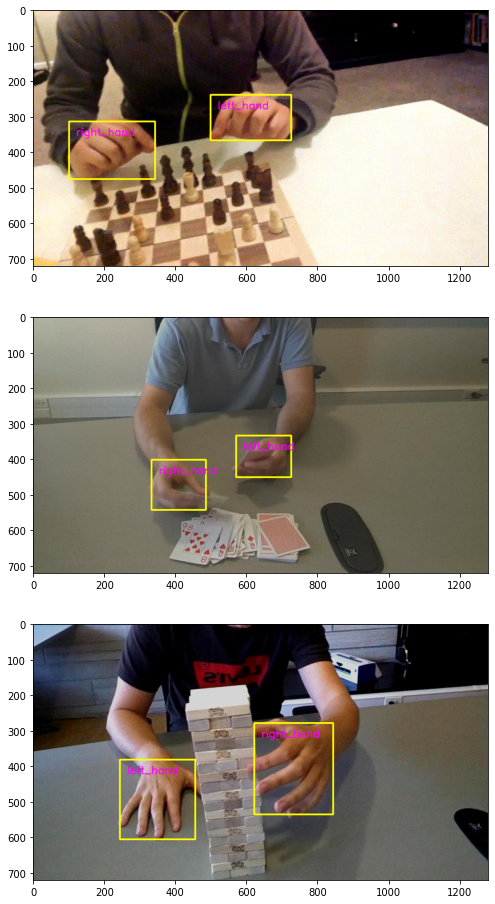

In [18]:
# testing if the argumenation worked
base_path = "data/egohands/train"

filenames = [image.replace(".jpg", "") for image in 
             os.listdir(base_path) 
             if image.endswith(".jpg") and image.startswith("aug")]

# display 3 random images again

fig=plt.figure(figsize=(16, 16))
columns = 1
rows = 3
for i in range(1, columns*rows +1):
    picture = random.sample(filenames, 3)[0]
    boxes, labels, image = load_image(os.path.join(base_path, picture), draw_boxes=True, np_array=True)
    fig.add_subplot(rows, columns, i)
    plt.imshow(image)
plt.show()

The Data is not in in a valid Pascal VoC format. Therefore we have to do that to be able to use it. 

In [19]:
# custom code to create a valid pascal format out of the dowloaded data
import os
import shutil
import fileinput
#create required direcotry

#shutil.rmtree('data/voc_egohands')

original_path = "data/egohands"

if not os.path.exists("data/voc_egohands"):
  os.makedirs("data/voc_egohands/Annotations")
  os.makedirs("data/voc_egohands/ImageSets/Main")
  os.makedirs("data/voc_egohands/JPEGImages")

classes= ["left_hand", "right_hand"]
with open("data/voc_egohands/labels.txt", "x") as file:
  for c in classes:
    file.write(c)
    file.write("\n")
  file.close()

# move all the files
source_dir_annotation = [original_path + '/test', original_path + '/train', original_path + '/valid']
target_dir_annotation = 'data/voc_egohands/Annotations'

for source_dir in source_dir_annotation:  
  file_names = os.listdir(source_dir)
      
  for file_name in file_names:
    if file_name.endswith("xml"):
      shutil.copy(os.path.join(source_dir, file_name), target_dir_annotation)

source_dir_images = [original_path + '/test', original_path + '/train', original_path + '/valid']
target_dir_images = 'data/voc_egohands/JPEGImages'

for source_dir in source_dir_images:  
  file_names = os.listdir(source_dir)
      
  for file_name in file_names:
    if file_name.endswith("jpg"):
      shutil.copy(os.path.join(source_dir, file_name), target_dir_images)

#create image set files
test_c = 0
with open("data/voc_egohands/ImageSets/Main/test.txt", "x") as file:
  for file_name in os.listdir(original_path + "/test"):
    if file_name.endswith("jpg"):
      file.write(file_name[:-4])
      file.write("\n")
      test_c += 1
  file.close()

train_c = 0
with open("data/voc_egohands/ImageSets/Main/trainval.txt", "x") as file:
  for file_name in os.listdir(original_path + "/train"):
    if file_name.endswith("jpg"):
      file.write(file_name[:-4])
      file.write("\n")
      train_c += 1
  file.close()

val_c = 0
with open("data/voc_egohands/ImageSets/Main/val.txt", "x") as file:
  for file_name in os.listdir(original_path +"/valid"):
    if file_name.endswith("jpg"):
      file.write(file_name[:-4])
      file.write("\n")
      val_c += 1
  file.close()

#replace classes in annotations by just hand
file_names = os.listdir("data/voc_egohands/Annotations")
for file_name in file_names:
  with fileinput.FileInput("data/voc_egohands/Annotations/" + file_name, inplace=True) as file:
      for line in file:
          new_line = line
          new_line = new_line.replace("yourleft", "left_hand")
          new_line = new_line.replace("yourright", "right_hand")
          print(new_line, end='')

print("Loading {0} testing images".format(test_c))
print("Loading {0} training images".format(train_c))
print("Loading {0} validation images".format(val_c))


Loading 303 testing images
Loading 2556 training images
Loading 288 validation images


## Model Training

In [42]:
import time

# helper function for training 
def train(loader, net, criterion, optimizer, device, epochs=5, model_prefix="", save_path="", save_model=True):
  net.train(True)
  start = time.localtime()

  best_loss = -1

  history = {"train_avg_loss": [], 
             "train_regression_loss": [],
             "train_classification_loss": [],
             "val_avg_loss": [],
             "val_regression_loss": [],
             "val_classification_loss": []}

  for epoch in range(epochs):
      start_epoch = time.localtime()
      scheduler.step()
      running_loss = 0.0
      running_regression_loss = 0.0
      running_classification_loss = 0.0
      for i, data in enumerate(loader):
       
          images, boxes, labels = data
          images = images.to(device)
          boxes = boxes.to(device)
          labels = labels.to(device)

          optimizer.zero_grad()
          confidence, locations = net(images)
          regression_loss, classification_loss = criterion(confidence, locations, labels, boxes)  
          loss = regression_loss + classification_loss
          loss.backward()
          optimizer.step()

          running_loss += loss.item()
          running_regression_loss += regression_loss.item()
          running_classification_loss += classification_loss.item()
        

      avg_loss = running_loss / len(loader)
      avg_reg_loss = running_regression_loss / len(loader)
      avg_clf_loss = running_classification_loss / len(loader)
      print(
          f"Epoch: {epoch}, " +
          f"Avg Train Loss: {avg_loss:.4f}, " +
          f"Avg Train Regression Loss {avg_reg_loss:.4f}, " +
          f"Avg Train Classification Loss: {avg_clf_loss:.4f}"
      )
      history["train_avg_loss"].append(avg_loss)
      history["train_regression_loss"].append(avg_reg_loss)
      history["train_classification_loss"].append(avg_clf_loss)

      running_loss = 0.0
      running_regression_loss = 0.0
      running_classification_loss = 0.0
      

      val_loss, val_regression_loss, val_classification_loss = test(val_loader, net, criterion, DEVICE)

      print(
          f"Epoch: {epoch}, " +
          f"Validation Loss: {val_loss:.4f}, " +
          f"Validation Regression Loss {val_regression_loss:.4f}, " +
          f"Validation Classification Loss: {val_classification_loss:.4f}"
      )

      history["val_avg_loss"].append(val_loss)
      history["val_regression_loss"].append(val_regression_loss)
      history["val_classification_loss"].append(val_classification_loss)

      if (best_loss == -1 or val_loss < best_loss) and save_model:
          model_path = os.path.join(save_path, f"{model_prefix}-{epoch}-Loss-{val_loss}.pth")
          net.save(model_path)
          print(f"Saved model {model_path}")
          best_loss = val_loss
      end_epoch = time.localtime()
      print("Training epoch " + str(epoch) + " took " + str(end_epoch.tm_min - start_epoch.tm_min) + " Minutes")

  end = time.localtime()
  print("Training overall took " + str(end.tm_min - start.tm_min) + " Minutes")
  return history

#helper function for testing
def test(loader, net, criterion, device):
    net.eval()
    running_loss = 0.0
    running_regression_loss = 0.0
    running_classification_loss = 0.0
    num = 0
    for _, data in enumerate(loader):
        images, boxes, labels = data
        images = images.to(device)
        boxes = boxes.to(device)
        labels = labels.to(device)
        num += 1

        with torch.no_grad():
            confidence, locations = net(images)
            regression_loss, classification_loss = criterion(confidence, locations, labels, boxes)
            loss = regression_loss + classification_loss

        running_loss += loss.item()
        running_regression_loss += regression_loss.item()
        running_classification_loss += classification_loss.item()
    return running_loss / num, running_regression_loss / num, running_classification_loss / num

In [43]:
import torch
import os
import itertools

from torch.utils.data import DataLoader, ConcatDataset
from torch.optim.lr_scheduler import CosineAnnealingLR, MultiStepLR, StepLR

from vision.utils.misc import str2bool, Timer, freeze_net_layers, store_labels
from vision.ssd.ssd import MatchPrior
from vision.ssd.mobilenetv1_ssd import create_mobilenetv1_ssd
from vision.datasets.voc_dataset import VOCDataset
from vision.datasets.open_images import OpenImagesDataset
from vision.nn.multibox_loss import MultiboxLoss
from vision.ssd.config import mobilenetv1_ssd_config as config
from vision.ssd.data_preprocessing import TrainAugmentation, TestTransform


# setup ssd net

from torch.utils.data import DataLoader, ConcatDataset
from torch.optim.lr_scheduler import CosineAnnealingLR, MultiStepLR

DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


# create data transforms for train/test/val
train_transform = TrainAugmentation(
    config.image_size, config.image_mean, config.image_std)
target_transform = MatchPrior(config.priors, config.center_variance,
                              config.size_variance, 0.5)

test_transform = TestTransform(config.image_size, config.image_mean, config.image_std)

datasets = []
dataset_path = "data/voc_egohands"
dataset = VOCDataset(dataset_path, transform=train_transform,
                      target_transform=target_transform)
label_file = os.path.join("models", "labels.txt")
store_labels(label_file, dataset.class_names)
num_classes = len(dataset.class_names)

datasets.append(dataset)

# create training dataset
train_dataset = ConcatDataset(datasets)
train_loader = DataLoader(train_dataset, 32,
                          num_workers=1,
                          shuffle=True)

# create validation dataset                           
val_dataset = VOCDataset(dataset_path, transform=test_transform,
                          target_transform=target_transform, is_test=True)

val_loader = DataLoader(val_dataset, 32,
                        num_workers=1,
                        shuffle=True)
num_classes = len(dataset.class_names)
print("Creating ssd with " + str(num_classes) + " classes")
net = create_mobilenetv1_ssd(num_classes)

# load weights of pretrained mobilenet ssd
net.init_from_pretrained_ssd("models/mobilenet/mobilenet-v1-ssd-mp-0_675.pth")


min_loss = -10000.0
last_epoch = -1

# move the model to GPU
net.to(DEVICE)




warning - image PUZZLE_LIVINGROOM_H_S_frame_1222_jpg.rf.773d2fc59bb386ffaab876d23d361f45 has no box/labels annotations, ignoring from dataset
warning - image aug-6SYZ0JENGA_LIVINGROOM_B_H_frame_2678_jpg.rf.1ba7e25bdc663390788355e230bdf08c has no box/labels annotations, ignoring from dataset
warning - image JENGA_LIVINGROOM_B_H_frame_2678_jpg.rf.1ba7e25bdc663390788355e230bdf08c has no box/labels annotations, ignoring from dataset
warning - image aug-UQ4RZJENGA_COURTYARD_S_T_frame_0002_jpg.rf.731c26c1099e953aabb41e5cc70c8eeb has no box/labels annotations, ignoring from dataset
warning - image JENGA_COURTYARD_S_T_frame_0024_jpg.rf.060b3c43877c11791c8e247b5825ae10 has no box/labels annotations, ignoring from dataset
warning - image aug-P2PDOJENGA_LIVINGROOM_S_T_frame_1990_jpg.rf.6fabaf5116fc4089d8006b2e800aab9a has no box/labels annotations, ignoring from dataset
warning - image JENGA_LIVINGROOM_S_T_frame_1990_jpg.rf.6fabaf5116fc4089d8006b2e800aab9a has no box/labels annotations, ignoring 

SSD(
  (base_net): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=64, bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 128, kernel_size=(1, 1), st

In [44]:
# train ssd


#define parameters

lr = 0.1
base_net_lr = 0.01
extra_layers_lr = 0.1
   

params = [
    {'params': net.base_net.parameters(), 'lr': base_net_lr},
    {'params': itertools.chain(
        net.source_layer_add_ons.parameters(),
        net.extras.parameters()
    ), 'lr': extra_layers_lr},
    {'params': itertools.chain(
        net.regression_headers.parameters(),
        net.classification_headers.parameters()
    )}
]
  
# define loss function and optimizer
criterion = MultiboxLoss(config.priors, iou_threshold=0.5, neg_pos_ratio=3,
                          center_variance=0.1, size_variance=0.2, device=DEVICE)
optimizer = torch.optim.SGD(params, lr=lr, momentum=0.9,
                            weight_decay=0.0005)

scheduler = CosineAnnealingLR(optimizer, len(train_loader), verbose=True)

history = train(train_loader, net, criterion, optimizer, DEVICE, epochs=1, model_prefix="EGOHANDS", save_path="models/egohands", save_model=True)

Adjusting learning rate of group 0 to 1.0000e-02.
Adjusting learning rate of group 1 to 1.0000e-01.
Adjusting learning rate of group 2 to 1.0000e-01.
Adjusting learning rate of group 0 to 9.9960e-03.
Adjusting learning rate of group 1 to 9.9960e-02.
Adjusting learning rate of group 2 to 9.9960e-02.


/usr/local/lib/python3.6/dist-packages/torch/optim/lr_scheduler.py:136: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)
/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


Epoch: 0, Avg Train Loss: 0.1454, Avg Train Regression Loss 0.0411, Avg Train Classification Loss: 0.1043
Epoch: 0, Validation Loss: 14.2036, Validation Regression Loss 2.6016, Validation Classification Loss: 11.6020
Saved model models/egohands/EGOHANDS-0-Loss-14.203587436676026.pth
Training epoch 0 took 0 Minutes
Training overall took 0 Minutes


In [45]:
history

{'train_avg_loss': [0.14540974097915843],
 'train_classification_loss': [0.10433792162545119],
 'train_regression_loss': [0.04107181633575053],
 'val_avg_loss': [14.203587436676026],
 'val_classification_loss': [11.601956653594971],
 'val_regression_loss': [2.601630687713623]}

## Model Evaluation

In [ ]:
import matplotlib.pyplot as plt

plt.plot(val_losses)
plt.show()

NameError: ignored

Inference time:  0.006023883819580078
right_hand: 0.53
right_hand: 0.37
right_hand: 0.11
right_hand: 0.10
Found 4 objects


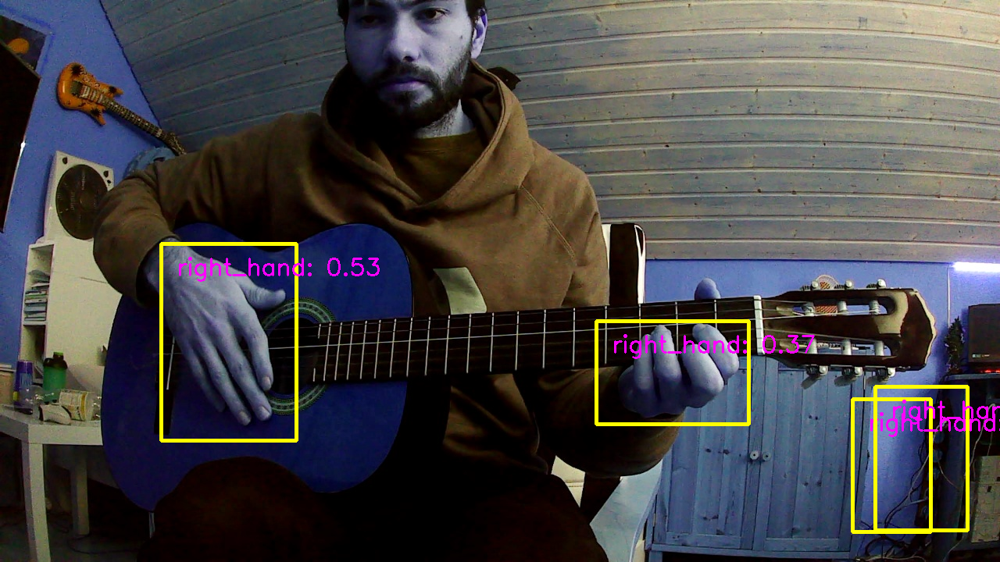

In [ ]:

from PIL import Image
from vision.ssd.mobilenetv1_ssd import create_mobilenetv1_ssd_predictor
from vision.ssd.mobilenetv1_ssd import create_mobilenetv1_ssd

import cv2

model_path = "models/SSD-HANDS2-Epoch-13-Loss-2.3289446592330934.pth"
label_path = "models/labels.txt"
image_path = "9-5.jpg"

class_names = [name.strip() for name in open(label_path).readlines()]


net_test = create_mobilenetv1_ssd(len(class_names), is_test=True)

net_test.load(model_path)

net_test.eval()

predictor = create_mobilenetv1_ssd_predictor(net_test, candidate_size=200)


orig_image = cv2.imread(image_path)
image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2RGB)
boxes, labels, probs = predictor.predict(image, 5, 0.1)


for i in range(boxes.size(0)):
    box = boxes[i, :]
    cv2.rectangle(orig_image, (box[0], box[1]), (box[2], box[3]), (255, 255, 0), 4)
    #label = f"""{voc_dataset.class_names[labels[i]]}: {probs[i]:.2f}"""
    label = f"{class_names[labels[i]]}: {probs[i]:.2f}"
    print(label)
    cv2.putText(orig_image, label,
                (box[0] + 20, box[1] + 40),
                cv2.FONT_HERSHEY_SIMPLEX,
                1,  # font scale
                (255, 0, 255),
                2)  # line type
print(f"Found {len(probs)} objects")
Image.fromarray(orig_image)

# Guitar Hands Detector

In [ ]:
#shutil.rmtree('data/guitar_hands')

In [ ]:
!curl -L "https://app.roboflow.com/ds/R6At7y4PtB?key=QE6UDDTvhH" > roboflow.zip; unzip roboflow.zip -d data/guitar_hands; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   886  100   886    0     0   1130      0 --:--:-- --:--:-- --:--:--  1128
100 35.2M  100 35.2M    0     0  32.9M      0  0:00:01  0:00:01 --:--:-- 32.9M
Archive:  roboflow.zip
replace data/guitar_hands/README.roboflow.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

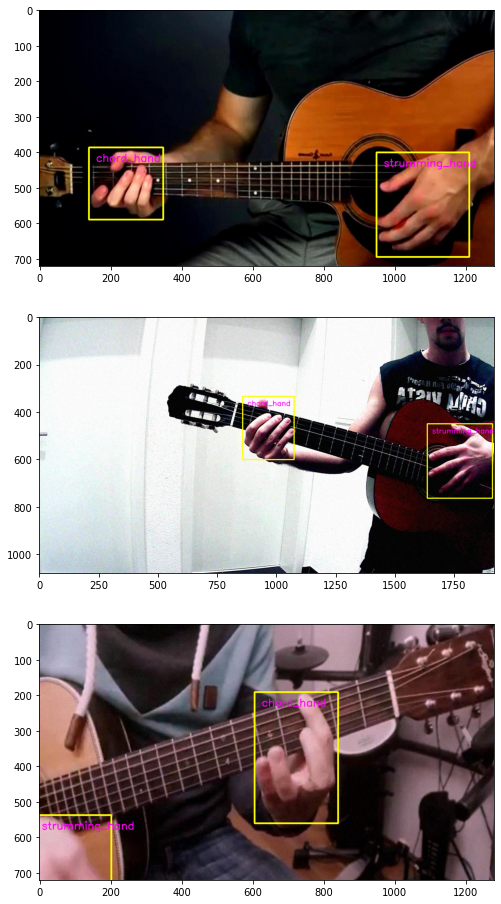

In [ ]:
import matplotlib.pyplot as plt


base_path = "data/guitar_hands/train"

filenames = [image.replace(".jpg", "") for image in 
             os.listdir(base_path) 
             if image.endswith(".jpg")]



fig=plt.figure(figsize=(16, 16))
columns = 1
rows = 3
for i in range(1, columns*rows +1):
    picture = random.sample(filenames, 3)[0]
    boxes, labels, image = load_image(os.path.join(base_path, picture), draw_boxes=True, np_array=True)
    fig.add_subplot(rows, columns, i)
    plt.imshow(image)
plt.show()

In [ ]:
print("The dataset contains {} training images".format(len(filenames)))

The dataset contains 1020 training images


In [ ]:
# apply the argumentation on the whole dataset for test, train and valid
source_dirs = ['data/guitar_hands/train', 'data/guitar_hands/test', 'data/guitar_hands/valid']

for source_dir in source_dirs:
  filenames = [image.replace(".jpg", "") for image in 
              os.listdir(source_dir) 
              if image.endswith(".jpg")]
  print("Applying image argumentation on {} images in the folder {}".format(len(filenames), source_dir))
  for picture in filenames:
    apply_augumentation(picture, multiply=3, save=True,  source_dir=source_dir, dest_dir=source_dir)


Applying image argumentation on 1020 images in the folder data/guitar_hands/train


KeyboardInterrupt: ignored

In [ ]:
base_path = "data/guitar_hands"

sets = ["test", "train", "valid"]

for set in sets:
  filenames = [image.replace(".jpg", "") for image in 
              os.listdir(os.path.join(base_path, set)) 
              if image.endswith(".jpg")]
  print("The set {} contains now {} images".format(set, len(filenames)))

The set test contains now 148 images
The set train contains now 1060 images
The set valid contains now 292 images


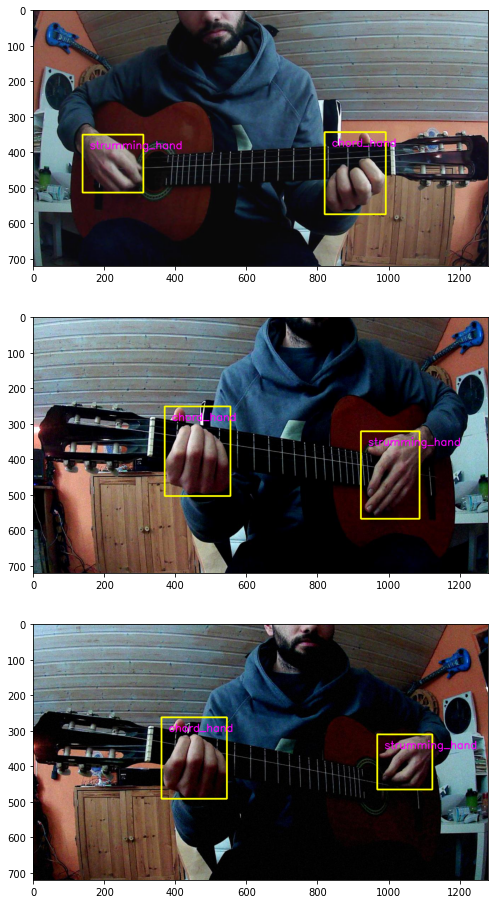

In [ ]:
# testing if the argumenation worked
base_path = "data/guitar_hands/train"

filenames = [image.replace(".jpg", "") for image in 
             os.listdir(base_path) 
             if image.endswith(".jpg") and image.startswith("aug")]

# display 3 random images again

fig=plt.figure(figsize=(16, 16))
columns = 1
rows = 3
for i in range(1, columns*rows +1):
    picture = random.sample(filenames, 3)[0]
    boxes, labels, image = load_image(os.path.join(base_path, picture), draw_boxes=True, np_array=True)
    fig.add_subplot(rows, columns, i)
    plt.imshow(image)
plt.show()

In [ ]:
#convert all the data also to voc
# custom code to create a valid pascal format out of the dowloaded data
import os
import shutil
import fileinput
#create required direcotry

#shutil.rmtree('data/voc_egohands')

original_path = "data/guitar_hands"

if not os.path.exists("data/voc_guitar_hands"):
  os.makedirs("data/voc_guitar_hands/Annotations")
  os.makedirs("data/voc_guitar_hands/ImageSets/Main")
  os.makedirs("data/voc_guitar_hands/JPEGImages")

classes= ["chord_hand", "strumming_hand"]
with open("data/voc_guitar_hands/labels.txt", "x") as file:
  for c in classes:
    file.write(c)
    file.write("\n")
  file.close()

# move all the files
source_dir_annotation = [original_path + '/test', original_path + '/train', original_path + '/valid']
target_dir_annotation = 'data/voc_guitar_hands/Annotations'

for source_dir in source_dir_annotation:  
  file_names = os.listdir(source_dir)
      
  for file_name in file_names:
    if file_name.endswith("xml"):
      shutil.copy(os.path.join(source_dir, file_name), target_dir_annotation)

source_dir_images = [original_path + '/test', original_path + '/train', original_path + '/valid']
target_dir_images = 'data/voc_guitar_hands/JPEGImages'

for source_dir in source_dir_images:  
  file_names = os.listdir(source_dir)
      
  for file_name in file_names:
    if file_name.endswith("jpg"):
      shutil.copy(os.path.join(source_dir, file_name), target_dir_images)

#create image set files
test_c = 0
with open("data/voc_guitar_hands/ImageSets/Main/test.txt", "x") as file:
  for file_name in os.listdir(original_path + "/test"):
    if file_name.endswith("jpg"):
      file.write(file_name[:-4])
      file.write("\n")
      test_c += 1
  file.close()

train_c = 0
with open("data/voc_guitar_hands/ImageSets/Main/trainval.txt", "x") as file:
  for file_name in os.listdir(original_path + "/train"):
    if file_name.endswith("jpg"):
      file.write(file_name[:-4])
      file.write("\n")
      train_c += 1
  file.close()

val_c = 0
with open("data/voc_guitar_hands/ImageSets/Main/val.txt", "x") as file:
  for file_name in os.listdir(original_path +"/valid"):
    if file_name.endswith("jpg"):
      file.write(file_name[:-4])
      file.write("\n")
      val_c += 1
  file.close()


print("Loading {0} testing images".format(test_c))
print("Loading {0} training images".format(train_c))
print("Loading {0} validation images".format(val_c))


In [ ]:
  
import torch
import os
import itertools

from torch.utils.data import DataLoader, ConcatDataset
from torch.optim.lr_scheduler import CosineAnnealingLR, MultiStepLR, StepLR

from vision.utils.misc import str2bool, Timer, freeze_net_layers, store_labels
from vision.ssd.ssd import MatchPrior
from vision.ssd.mobilenetv1_ssd import create_mobilenetv1_ssd
from vision.datasets.voc_dataset import VOCDataset
from vision.datasets.open_images import OpenImagesDataset
from vision.nn.multibox_loss import MultiboxLoss
from vision.ssd.config import mobilenetv1_ssd_config as config
from vision.ssd.data_preprocessing import TrainAugmentation, TestTransform


# setup ssd net

from torch.utils.data import DataLoader, ConcatDataset
from torch.optim.lr_scheduler import CosineAnnealingLR, MultiStepLR

DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


# create data transforms for train/test/val
train_transform = TrainAugmentation(
    config.image_size, config.image_mean, config.image_std)
target_transform = MatchPrior(config.priors, config.center_variance,
                              config.size_variance, 0.5)

test_transform = TestTransform(config.image_size, config.image_mean, config.image_std)

datasets = []
dataset_path = "data/voc_guitar_hands"
dataset = VOCDataset(dataset_path, transform=train_transform,
                      target_transform=target_transform)
label_file = os.path.join("models", "labels.txt")
store_labels(label_file, dataset.class_names)
num_classes = len(dataset.class_names)

datasets.append(dataset)

# create training dataset
train_dataset = ConcatDataset(datasets)
train_loader = DataLoader(train_dataset, 50,
                          num_workers=1,
                          shuffle=True)

# create validation dataset                           
val_dataset = VOCDataset(dataset_path, transform=test_transform,
                          target_transform=target_transform, is_test=True)

val_loader = DataLoader(val_dataset, 30,
                        num_workers=1,
                        shuffle=True)
num_classes = len(dataset.class_names)
print("Creating ssd with " + str(num_classes) + " classes")
net = create_mobilenetv1_ssd(num_classes)

# load weights of pretrained mobilenet ssd
net.init_from_pretrained_ssd("models/mobilenet-v1-ssd-mp-0_675.pth")


min_loss = -10000.0
last_epoch = -1

# move the model to GPU
net.to(DEVICE)


val_losses = []
val_regression_losses = []
val_classification_losses = []


Creating ssd with 3 classes


In [ ]:
 from torchsummary import summary
 count = 0
 for param in net.parameters():
            count +=1
            if count < 100: #freezing first 100 layers
                param.requires_grad = False

summary(net, input_size=config.image_size)

In [ ]:
# train ssd
import time

#define parameters

lr = 0.1
base_net_lr = 0.01
extra_layers_lr = 0.1
   

params = [
    {'params': net.base_net.parameters(), 'lr': base_net_lr},
    {'params': itertools.chain(
        net.source_layer_add_ons.parameters(),
        net.extras.parameters()
    ), 'lr': extra_layers_lr},
    {'params': itertools.chain(
        net.regression_headers.parameters(),
        net.classification_headers.parameters()
    )}
]

# define loss function and optimizer
criterion = MultiboxLoss(config.priors, iou_threshold=0.5, neg_pos_ratio=3,
                          center_variance=0.1, size_variance=0.2, device=DEVICE)
optimizer = torch.optim.SGD(params, lr=lr, momentum=0.9,
                            weight_decay=0.0005)

scheduler = CosineAnnealingLR(optimizer, 3, verbose=True)

net.train()
start = time.localtime()

for epoch in range(5):
    start_epoch = time.localtime()
    scheduler.step()
    train(train_loader, net, criterion, optimizer,
          device=DEVICE, debug_steps=5, epoch=epoch)

    val_loss, val_regression_loss, val_classification_loss = test(val_loader, net, criterion, DEVICE)
    val_losses.append(val_loss)
    val_regression_losses.append(val_regression_loss) 
    val_classification_losses.append(val_classification_loss) 

    print(
        f"Epoch: {epoch}, " +
        f"Validation Loss: {val_loss:.4f}, " +
        f"Validation Regression Loss {val_regression_loss:.4f}, " +
        f"Validation Classification Loss: {val_classification_loss:.4f}"
    )
    model_path = os.path.join("models/", f"SSD-HANDS-Epoch-{epoch}-Loss-{val_loss}.pth")
    net.save(model_path)
    print(f"Saved model {model_path}")
    end_epoch = time.localtime()
    print("Training epoch " + str(epoch) + " took " + str(end_epoch.tm_min - start_epoch.tm_min) + " Minutes")

end = time.localtime()
print("Training epoch overall took " + str(end.tm_min - start.tm_min) + " Minutes")

Adjusting learning rate of group 0 to 1.0000e-02.
Adjusting learning rate of group 1 to 1.0000e-01.
Adjusting learning rate of group 2 to 1.0000e-01.
Adjusting learning rate of group 0 to 7.5000e-03.
Adjusting learning rate of group 1 to 7.5000e-02.
Adjusting learning rate of group 2 to 7.5000e-02.


/usr/local/lib/python3.6/dist-packages/torch/optim/lr_scheduler.py:136: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)
/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


Epoch: 0, Step: 5/21, Avg Loss: 17.5116, Avg Regression Loss 3.2256, Avg Classification Loss: 14.2859
Epoch: 0, Step: 10/21, Avg Loss: 10.9102, Avg Regression Loss 2.4809, Avg Classification Loss: 8.4293
Epoch: 0, Step: 15/21, Avg Loss: 6.7151, Avg Regression Loss 2.5553, Avg Classification Loss: 4.1598
Epoch: 0, Step: 20/21, Avg Loss: 5.8770, Avg Regression Loss 2.3065, Avg Classification Loss: 3.5705
Epoch: 0, Validation Loss: 7.1586, Validation Regression Loss 2.8478, Validation Classification Loss: 4.3107
Saved model models/SSD-HANDS-Epoch-0-Loss-7.158581733703613.pth
Training epoch 0 took 7 Minutes
Adjusting learning rate of group 0 to 2.5000e-03.
Adjusting learning rate of group 1 to 2.5000e-02.
Adjusting learning rate of group 2 to 2.5000e-02.
Epoch: 1, Step: 5/21, Avg Loss: 6.1365, Avg Regression Loss 2.4902, Avg Classification Loss: 3.6463
Epoch: 1, Step: 10/21, Avg Loss: 4.7275, Avg Regression Loss 1.8256, Avg Classification Loss: 2.9019
Epoch: 1, Step: 15/21, Avg Loss: 4.338

## Hyperparameter Optimization

In [ ]:
print("Setting up colab environment")
!pip uninstall -y -q pyarrow
!pip install -q -U ray[tune]
!pip install -q ray[debug]

Setting up colab environment


In [ ]:
import ray
from ray import tune
from ray.tune import track
from ray.tune.schedulers import AsyncHyperBandScheduler

In [ ]:
!ls

data	     onnx_export.py		requirements.txt
eval_ssd.py  open_images_classes.txt	run_ssd_example.py
LICENSE      open_images_downloader.py	train_ssd.py
models	     README.md			vision


In [ ]:
def train_hand_detector(ray_config):
    # create data transforms for train/test/val
    train_transform = TrainAugmentation(
        config.image_size, config.image_mean, config.image_std)
    target_transform = MatchPrior(config.priors, config.center_variance,
                                  config.size_variance, 0.5)

    test_transform = TestTransform(config.image_size, config.image_mean, config.image_std)

    datasets = []
    dataset_path = "/content/pytorch_ssd/data/voc_guitar_hands"
    dataset = VOCDataset(dataset_path, transform=train_transform,
                          target_transform=target_transform)
    label_file = os.path.join("/content/pytorch_ssd/models", "labels.txt")
    store_labels(label_file, dataset.class_names)
    num_classes = len(dataset.class_names)

    datasets.append(dataset)
    # create training dataset
    train_dataset = ConcatDataset(datasets)
    train_loader = DataLoader(train_dataset, int(ray_config["batch_size"]),
                              num_workers=1,
                              shuffle=True)

    # create validation dataset                           
    val_dataset = VOCDataset(dataset_path, transform=test_transform,
                              target_transform=target_transform, is_test=True)

    val_loader = DataLoader(val_dataset, 30,
                            num_workers=1,
                            shuffle=True)
    num_classes = len(dataset.class_names)
    print("Creating ssd with " + str(num_classes) + " classes")
    net = create_mobilenetv1_ssd(num_classes)

    # load weights of pretrained mobilenet ssd
    net.init_from_pretrained_ssd("/content/pytorch_ssd/models/mobilenet-v1-ssd-mp-0_675.pth")


    min_loss = -10000.0
    last_epoch = -1

    # move the model to GPU
    net.to(DEVICE)

    #define parameters

    lr = 0.1
    base_net_lr = 0.01
    extra_layers_lr = 0.1
      

    params = [
        {'params': net.base_net.parameters(), 'lr': base_net_lr},
        {'params': itertools.chain(
            net.source_layer_add_ons.parameters(),
            net.extras.parameters()
        ), 'lr': extra_layers_lr},
        {'params': itertools.chain(
            net.regression_headers.parameters(),
            net.classification_headers.parameters()
        )}
    ]

    # define loss function and optimizer
    criterion = MultiboxLoss(config.priors, iou_threshold=0.5, neg_pos_ratio=3,
                              center_variance=0.1, size_variance=0.2, device=DEVICE)
    optimizer = torch.optim.SGD(params, lr=lr, momentum=0.9,
                                weight_decay=0.0005)

    scheduler = CosineAnnealingLR(optimizer, 3, verbose=True)

    net.train()

    for epoch in range(5):
        scheduler.step()
        train(train_loader, net, criterion, optimizer,
              device=DEVICE, debug_steps=5, epoch=epoch)

        print("Validating model")
        val_loss, val_regression_loss, val_classification_loss = test(val_loader, net, criterion, DEVICE)
        val_losses.append(val_loss)
        val_regression_losses.append(val_regression_loss) 
        val_classification_losses.append(val_classification_loss) 

        print("Send result to ray")

        print(
            f"Epoch: {epoch}, " +
            f"Validation Loss: {val_loss:.4f}, " +
            f"Validation Regression Loss {val_regression_loss:.4f}, " +
            f"Validation Classification Loss: {val_classification_loss:.4f}"
        )
                
        tune.report(val_loss=val_loss, val_regression_loss=val_regression_loss, val_classification_loss=val_classification_loss)

    # free up ressources
    del model
    del val_loader
    del train_loader




In [ ]:
!ray stack

Stack dump for root        2293  0.4  0.2 3992912 27720 ?       Sl   14:09   0:08 /usr/local/lib/python3.6/dist-packages/ray/core/src/ray/raylet/raylet --raylet_socket_name=/tmp/ray/session_2020-12-31_14-09-25_462430_2162/sockets/raylet --store_socket_name=/tmp/ray/session_2020-12-31_14-09-25_462430_2162/sockets/plasma_store --object_manager_port=0 --min_worker_port=0 --max_worker_port=0 --node_manager_port=47249 --node_ip_address=172.28.0.2 --redis_address=172.28.0.2 --redis_port=6379 --num_initial_workers=2 --maximum_startup_concurrency=2 --static_resource_list=node:172.28.0.2,1.0,accelerator_type:T4,1,CPU,2,GPU,1,memory,147,object_store_memory,50 --config_list=plasma_store_as_thread,True --python_worker_command=/usr/bin/python3 /usr/local/lib/python3.6/dist-packages/ray/workers/default_worker.py --node-ip-address=172.28.0.2 --node-manager-port=47249 --object-store-name=/tmp/ray/session_2020-12-31_14-09-25_462430_2162/sockets/plasma_store --raylet-name=/tmp/ray/session_2020-12-31_14-

In [ ]:
search_space = {
    "batch_size": tune.grid_search([10, 30, 100, 200]), 
    #"lr": tune.sample_from(lambda spec: 10**(-10 * np.random.rand())),
}


analysis = tune.run(
    train_hand_detector,  
    config=search_space, 
    num_samples=1,  
    resources_per_trial={"gpu": 1},
    verbose=1,
    name="batch_size"  # This is used to specify the logging directory.
)

Trial name,# failures,error file
train_hand_detector_f76bc_00003,1,/root/ray_results/batch_size/train_hand_detector_f76bc_00003_3_batch_size=200_2020-12-31_15-09-28/error.txt


TuneError: ignored

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir ~/ray_results/batch_size

<IPython.core.display.Javascript object>

In [ ]:
import matplotlib.pyplot as plt

plt.plot(val_losses)
plt.show()

NameError: ignored

In [ ]:
padding = 40



def crop_image(org_frame, box):
    
    
    point1 = [box[0], box[1]]
    point2 = [box[2], box[3]]
    
    if box[0] - padding > 0:
        point1[0] = box[0] - padding
    else:
        point1[0] = 0 
    
    if box[1] - padding > 0:
        point1[1] = box[1] - padding
    else:
        point1[1] = 0 
        

    if box[2] + padding < 1280:
        point2[0] = box[2] + padding
    else:
        point2[0] = 1280
    
    if box[3] + padding < 720:
        point2[1] = box[3] + padding
    else:
        point2[1] = 720
        
    return Image.fromarray(org_frame).crop((point1[0], point1[1], point2[0], point2[1]))






Inference time:  0.10092997550964355
chord_hand: 0.15
strumming_hand: 0.83
Found 2 objects


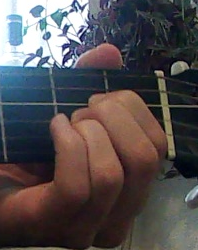

In [ ]:
from PIL import Image
from vision.ssd.mobilenetv1_ssd import create_mobilenetv1_ssd_predictor
from vision.ssd.mobilenetv1_ssd import create_mobilenetv1_ssd
import numpy as np

import cv2

model_path = "models/SSD-HANDS-Epoch-19-Loss-1.569869613647461.pth"
label_path = "models/labels.txt"
image_path = "data/dataset_third_val/a_chord/9-a_chord-11.jpg"

class_names = [name.strip() for name in open(label_path).readlines()]


net_test = create_mobilenetv1_ssd(len(class_names), is_test=True)

net_test.load(model_path)

net_test.eval()

predictor = create_mobilenetv1_ssd_predictor(net_test, candidate_size=200)


orig_image = cv2.imread(image_path)
image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2RGB)
boxes, labels, probs = predictor.predict(image, 5, 0.1)


for i in range(boxes.size(0)):
    box = boxes[i, :].numpy()
    #cv2.rectangle(orig_image, (box[0], box[1]), (box[2], box[3]), (255, 255, 0), 4)
    #label = f"""{voc_dataset.class_names[labels[i]]}: {probs[i]:.2f}"""
    label = f"{class_names[labels[i]]}: {probs[i]:.2f}"
    print(label)
    if class_names[labels[i]] == "chord_hand":
      orig_image = crop_image(orig_image, box)
    #cv2.putText(orig_image, label,
    #            (box[0] + 20, box[1] + 40),
     #           cv2.FONT_HERSHEY_SIMPLEX,
      #          1,  # font scale
       #         (255, 0, 255),
        #        2)  # line type
print(f"Found {len(probs)} objects")
Image.fromarray(cv2.cvtColor(np.array(orig_image), cv2.COLOR_BGR2RGB))

In [ ]:
from PIL import Image
from vision.ssd.mobilenetv1_ssd import create_mobilenetv1_ssd_predictor
from vision.ssd.mobilenetv1_ssd import create_mobilenetv1_ssd
import numpy as np

model_path = "models/SSD-HANDS-Epoch-19-Loss-1.569869613647461.pth"
label_path = "models/labels.txt"

class_names = [name.strip() for name in open(label_path).readlines()]


net_test = create_mobilenetv1_ssd(len(class_names), is_test=True)

net_test.load(model_path)

net_test.eval()

predictor = create_mobilenetv1_ssd_predictor(net_test, candidate_size=200)


def cut_chord_hand(image):
  np_image = np.array(image)
  boxes, labels, probs = predictor.predict(np_image, 5, 0.1)

  chord_hand = None
  for i in range(boxes.size(0)):
      box = boxes[i, :].numpy()
      if class_names[labels[i]] == "chord_hand":
        chord_hand = crop_image(np_image, box)
        break
  return chord_hand


In [ ]:
import shutil 
import os

#shutil.rmtree('data/dataset_third_cropped2')
#shutil.rmtree('data/dataset_third_val_cropped2')

shutil.copytree("data/dataset_third", "data/dataset_third_cropped2")
shutil.copytree("data/dataset_third_val", "data/dataset_third_val_cropped2")    

for path, subdirs, files in os.walk("data/dataset_third_cropped2"):
  for name in files:
    if name.endswith(".jpg"):
      img = Image.open(os.path.join(path, name))
      cut_image = cut_chord_hand(img)
      if cut_image != None:
        cut_image.save(os.path.join(path, name))
      else:
        print("Could no identify chord hand for image " + os.path.join(path, name))
        os.remove(os.path.join(path, name))
for path, subdirs, files in os.walk("data/dataset_third_val_cropped2"):
  for name in files:
    if name.endswith(".jpg"):
      img = Image.open(os.path.join(path, name))
      cut_image = cut_chord_hand(img)
      if cut_image != None:
        cut_image.save(os.path.join(path, name))
      else:
        print("Could no identify chord hand for image " + os.path.join(path, name))
        os.remove(os.path.join(path, name))


Inference time:  0.006231069564819336
Inference time:  0.005843400955200195
Inference time:  0.009209156036376953
Inference time:  0.006044626235961914
Inference time:  0.005807399749755859
Inference time:  0.008641242980957031
Inference time:  0.0063169002532958984
Inference time:  0.006266117095947266
Inference time:  0.005882978439331055
Inference time:  0.006304264068603516
Inference time:  0.005980491638183594
Inference time:  0.005922794342041016
Inference time:  0.007940292358398438
Inference time:  0.0062046051025390625
Inference time:  0.0057103633880615234
Inference time:  0.005811214447021484
Inference time:  0.0068933963775634766
Inference time:  0.005852937698364258
Inference time:  0.008166790008544922
Inference time:  0.006511688232421875
Inference time:  0.005571842193603516
Inference time:  0.0052337646484375
Inference time:  0.005370616912841797
Inference time:  0.0060536861419677734
Inference time:  0.005338430404663086
Inference time:  0.005275249481201172
Inference

# Chord Classification


In [ ]:
!unzip chords.zip -d data

Archive:  chords.zip
   creating: data/chords/
  inflating: data/chords/.DS_Store   
  inflating: data/__MACOSX/chords/._.DS_Store  
   creating: data/chords/test/
   creating: data/chords/train/
   creating: data/chords/val/
   creating: data/chords/test/a_chord/
   creating: data/chords/test/c_chord/
  inflating: data/chords/test/.DS_Store  
  inflating: data/__MACOSX/chords/test/._.DS_Store  
   creating: data/chords/test/d_chord/
   creating: data/chords/train/a_chord/
   creating: data/chords/train/c_chord/
  inflating: data/chords/train/.DS_Store  
  inflating: data/__MACOSX/chords/train/._.DS_Store  
   creating: data/chords/train/d_chord/
   creating: data/chords/val/a_chord/
   creating: data/chords/val/c_chord/
  inflating: data/chords/val/.DS_Store  
  inflating: data/__MACOSX/chords/val/._.DS_Store  
   creating: data/chords/val/d_chord/
  inflating: data/chords/test/a_chord/.DS_Store  
  inflating: data/__MACOSX/chords/test/a_chord/._.DS_Store  
  inflating: data/chords/te

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
import copy

In [ ]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

data_dir = 'data/chords'
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val', 'test']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=20,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val', 'test']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val', 'test']}
class_names = image_datasets['train'].classes

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

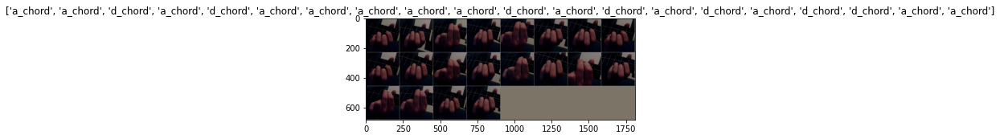

In [ ]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated


# Get a batch of training data
inputs, classes = next(iter(dataloaders['test']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title=[class_names[x] for x in classes])



In [ ]:
def train_model(model, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if phase == 'train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

In [ ]:
def visualize_model(model, num_images=8):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {} --- acutal {}'.format(class_names[preds[j]], class_names[labels[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

In [ ]:
model_ft = models.resnet18(pretrained=True)
num_ftrs = model_ft.fc.in_features
# Here the size of each output sample is set to 2.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
model_ft.fc = nn.Linear(num_ftrs, 3)

model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# Observe that all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

In [ ]:
model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler,
                       num_epochs=5)

Epoch 0/4
----------
train Loss: 0.8883 Acc: 0.6220
val Loss: 0.7546 Acc: 0.7109

Epoch 1/4
----------
train Loss: 0.2779 Acc: 0.9685
val Loss: 0.2732 Acc: 0.9453

Epoch 2/4
----------
train Loss: 0.0823 Acc: 1.0000
val Loss: 0.1997 Acc: 1.0000

Epoch 3/4
----------
train Loss: 0.0313 Acc: 1.0000


In [ ]:
torch.save(model_ft.state_dict(), "models/chord_classifier.pt")

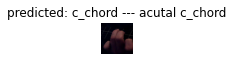

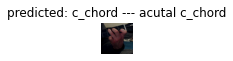

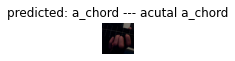

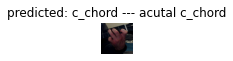

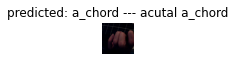

...

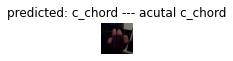

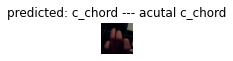

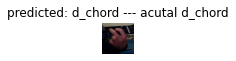

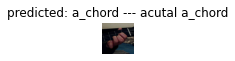

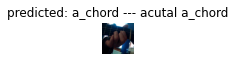

In [ ]:
visualize_model(model_ft, num_images=12)

c_chord


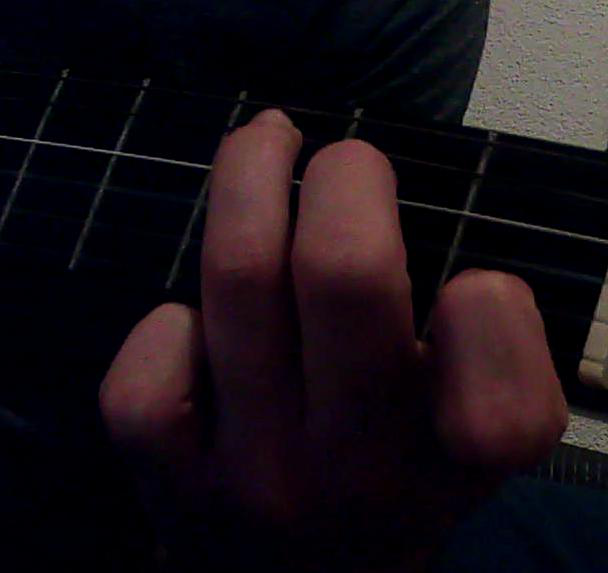

In [ ]:
from torch.autograd import Variable
from PIL import Image


imsize = 224
loader = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

def image_loader(image_name):
    """load image, returns cuda tensor"""
    image = Image.open(image_name)
    return image #assumes that you're using GPU

image = image_loader("data/chords/val/c_chord/c_chord52.jpg")


def predict(image):
    model_ft.eval()
    image = loader(image).float()
    image = Variable(image, requires_grad=True)
    image = image.unsqueeze(0)
    inputs = image.to(device)

    with torch.no_grad():
        outputs = model_ft(inputs)
        _, preds = torch.max(outputs, 1)
        return class_names[int(preds[0])]

print(predict(image))
image


        